In [1]:
import plot_functions
import compare_clusterings
import process_data
import visualizations

from compare_clusterings import *
from process_data import *
from plot_functions import *
from visualizations import *

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation

In [3]:
import traj_generator
import physics_sim_simple_moreparticles_proteins

import process_data

In [4]:
import numpy as np
import plotly.graph_objs as go

In [5]:
move_groups_nr = 3
particles_per_group = 100

explicit_groups = []
group_size = 10

curr_group = 0
while 1 == 1:
    for i in range(group_size):
        explicit_groups.append(curr_group%move_groups_nr)

        if len(explicit_groups) == particles_per_group:
            break
    if len(explicit_groups) == particles_per_group:
        break
    curr_group = curr_group + 1


In [6]:
explicit_groups

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [7]:
sim_command = "physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=1, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)"
particles_from_sim = eval(sim_command)

In [8]:
#particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=1, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [9]:
#particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=0, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [10]:
trajectories = process_data.simulation_to_array(particles_from_sim)

In [11]:
plot_functions.plot_traj_labels_plotly_2nd(trajectories)

In [12]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [13]:
num_groups

3

In [14]:
%matplotlib notebook


a = plot_functions.plot_traj_labels_plt(trajectories, save_video=False, interval = 10, title = sim_command + "\n Ground Truth", plt_fig_size=(10,7.5))

<IPython.core.display.Javascript object>

In [15]:
a

In [16]:
plt.show()

In [17]:
from IPython.display import HTML
HTML(a.to_html5_video())

In [18]:
df = process_data.create_clustering_df(trajectories)

In [19]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0344


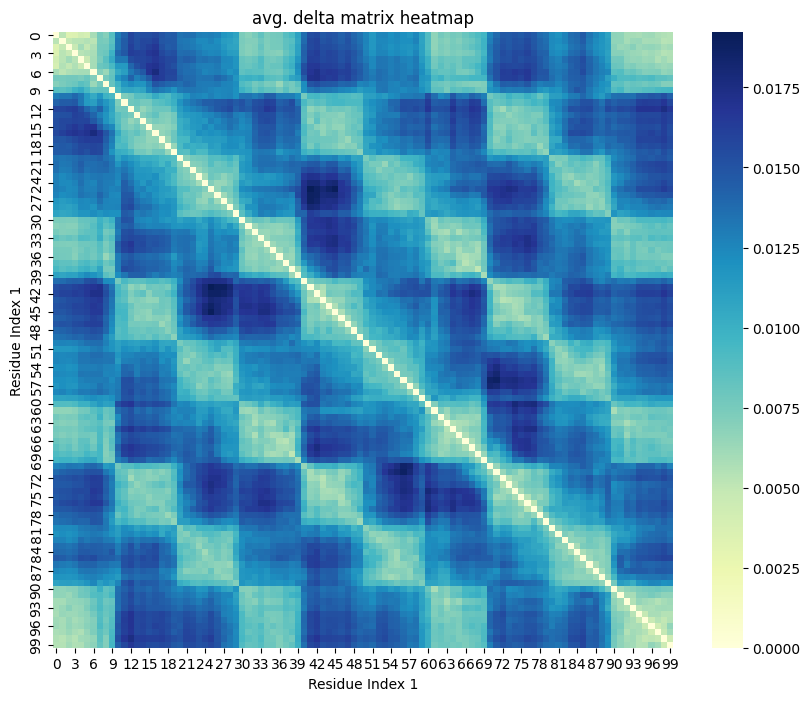

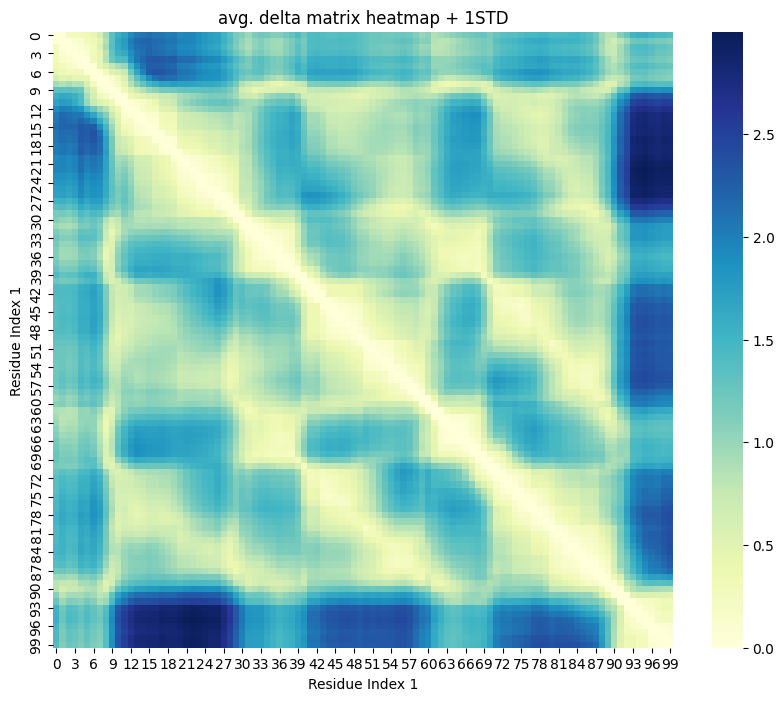

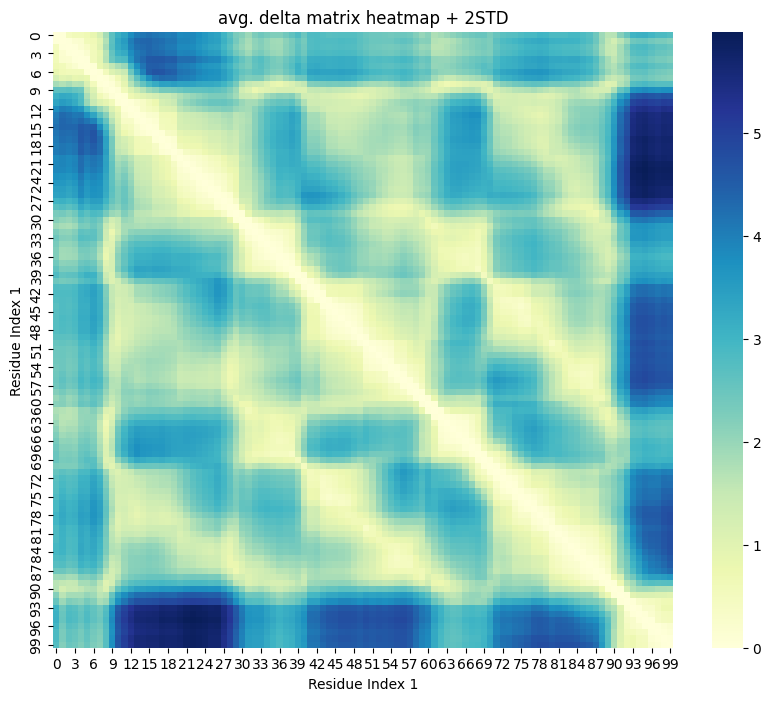

1.7106
something wrong with clustering Q computation


In [20]:
%matplotlib inline

res_hdbscan_2std = redpandda_general.main_clustering_general_std(df, None, clustering_algorithm="hdbscan")

In [21]:
res_hdbscan_2std

(array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]),
 [],
 array([[1.        , 0.99289926, 0.92087203, ..., 0.52201291, 0.52169927,
         0.53700132],
        [0.99289926, 1.        , 0.99347018, ..., 0.61550615, 0.61563392,
         0.62899022],
        [0.92087203, 0.99347018, 1.        , ..., 0.56321613, 0.56582605,
         0.57948685],
        ...,
        [0.52201291, 0.61550615, 0.56321613, ..., 1.        , 0.9915689 ,
         0.98026435],
        [0.52169927, 0.61563392, 0.56582605, ..., 0.9915689 , 1.        ,
         0.99335878],
        [0.53700132, 0.62899022, 0.57948685, ..., 0.

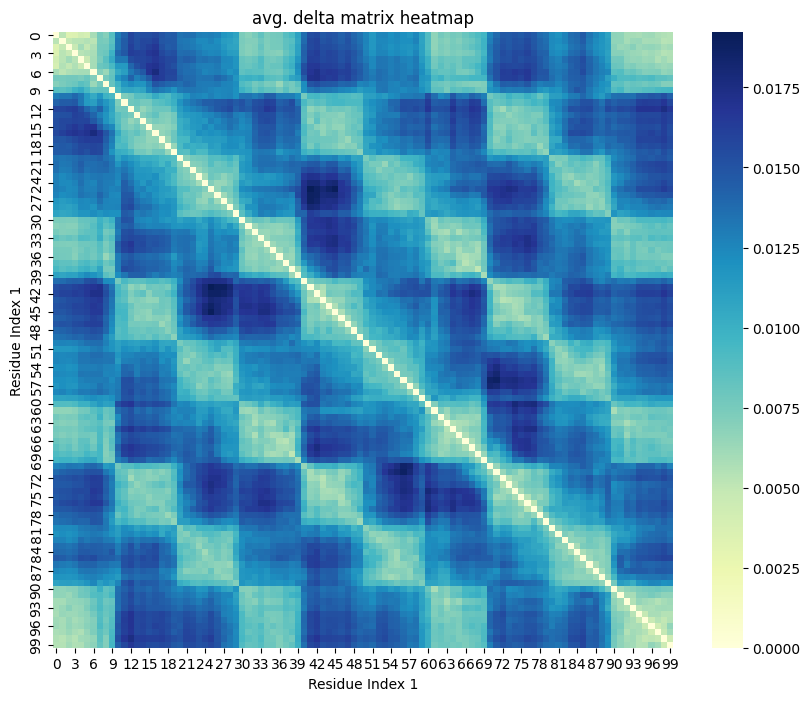

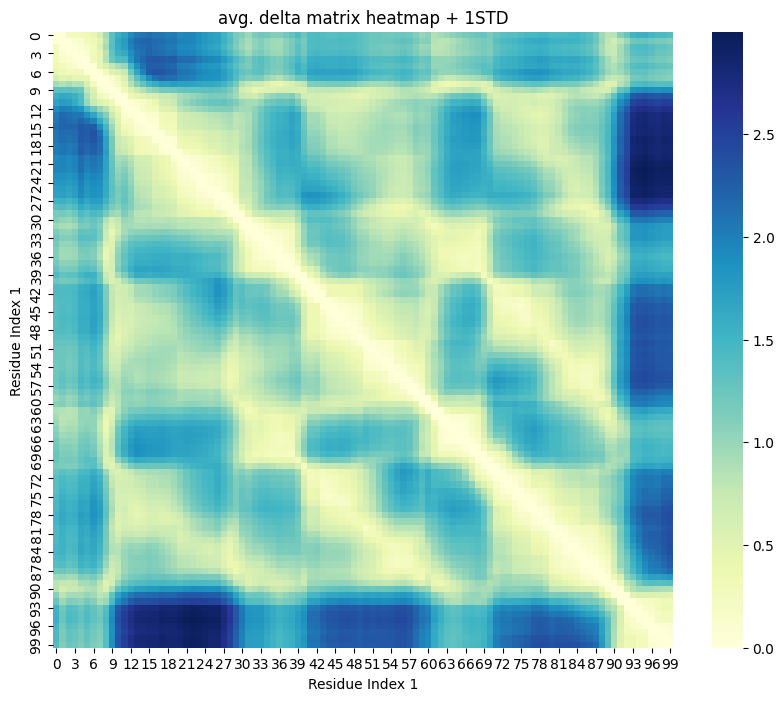

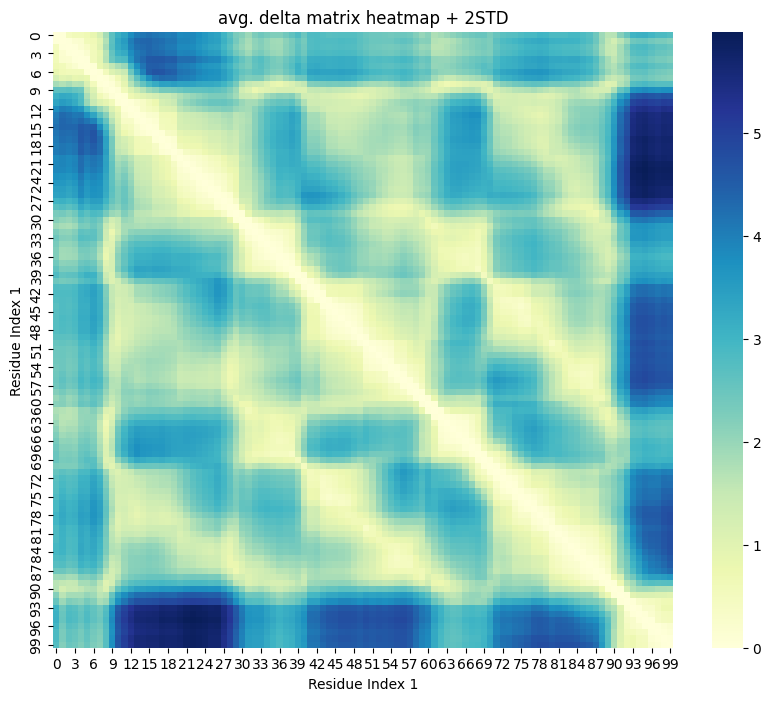

1.5546
something wrong with clustering Q computation


In [22]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

In [23]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0082


In [24]:
res_hdbscan

(array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 4.128514605908889,
 array([[0.99968977, 0.99977366, 0.99974535, ..., 0.99978236, 0.99978021,
         0.99977725],
        [0.99977366, 0.99968977, 0.99976963, ..., 0.99978513, 0.99977702,
         0.99977751],
        [0.99974535, 0.99976963, 0.99968977, ..., 0.99979167, 0.99978338,
         0.99978724],
        ...,
        [0.99978236, 0.99978513, 0.99979167, ..., 0.99968977, 0.9997693 ,
         0.99978703],
        [0.99978021, 0.99977702, 0.99978338, ..., 0.9997693 , 0.99968977,
         0.99976187],
        [0.99977725, 0.99977751, 0.99978724, ..., 0.99978703, 0.99976187,
         0.99968977]]),
 [array([[ 0],
         [ 1],
         [ 2],
  

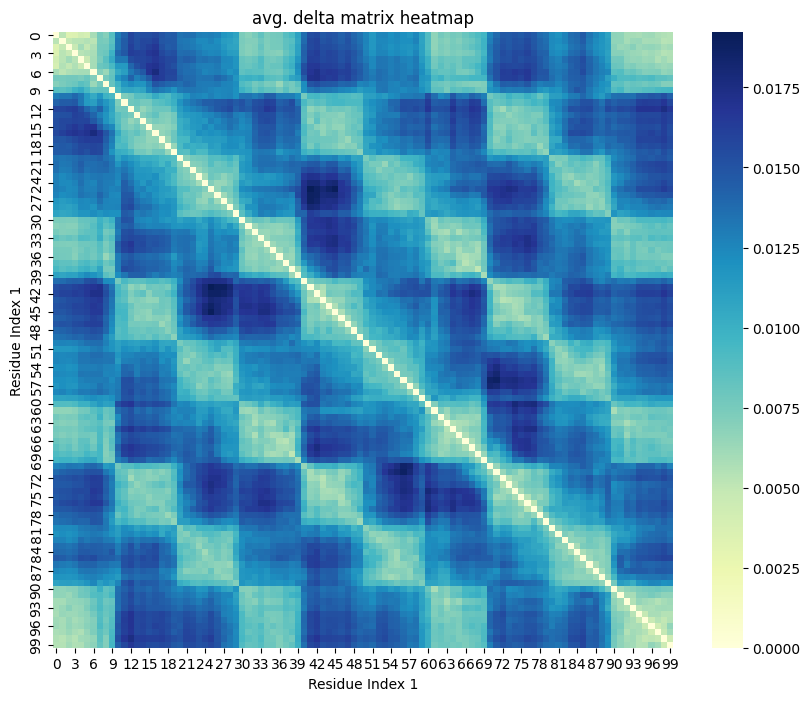

0.5532


In [25]:
res = redpandda_general.main_clustering_general(df, 2)

In [26]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0104


In [27]:
res_hdbscan

(array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 4.128514605908889,
 array([[0.99968977, 0.99977366, 0.99974535, ..., 0.99978236, 0.99978021,
         0.99977725],
        [0.99977366, 0.99968977, 0.99976963, ..., 0.99978513, 0.99977702,
         0.99977751],
        [0.99974535, 0.99976963, 0.99968977, ..., 0.99979167, 0.99978338,
         0.99978724],
        ...,
        [0.99978236, 0.99978513, 0.99979167, ..., 0.99968977, 0.9997693 ,
         0.99978703],
        [0.99978021, 0.99977702, 0.99978338, ..., 0.9997693 , 0.99968977,
         0.99976187],
        [0.99977725, 0.99977751, 0.99978724, ..., 0.99978703, 0.99976187,
         0.99968977]]),
 [array([[ 0],
         [ 1],
         [ 2],
  

In [28]:
res

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 8.72246413216386,
 [],
 [array([[ 0],
         [ 1],
         [ 2],
         [ 3],
         [ 4],
         [ 5],
         [ 6],
         [ 7],
         [ 8],
         [ 9],
         [10],
         [11],
         [12],
         [13],
         [14],
         [15],
         [16],
         [17],
         [18],
         [19],
         [20],
         [21],
         [22],
         [23],
         [24],
         [25],
         [26],
         [27],
         [28],
         [29],
         [30],
         [31],
         [32],
         [33],
         [34],
         [35],
         [36],
         [37],
         [38],
         [39],
         [40],
         [41],
    

In [29]:
res_agglon = redpandda_general.main_clustering_general(df, None, clustering_algorithm="agglomerative")

something wrong with clustering Q computation


In [30]:
res_agglon

(array([99, 92, 98, 96, 95, 94, 55, 63, 83, 49, 75, 87, 59, 81, 47, 62, 53,
        64, 56, 50, 67, 61, 79, 73, 89, 57, 69, 30, 97, 88, 85, 93, 84, 31,
        52, 65, 58, 90, 46, 76, 60, 78, 51, 44, 41, 72, 82, 28, 91, 68, 24,
        54, 66, 29, 70, 33, 14, 26, 32, 80, 45, 39, 27, 43, 13, 40, 86, 37,
        74, 48, 36, 25, 71, 42, 35, 77, 22, 38, 12, 34, 15, 21, 16, 20, 19,
        23,  9,  6, 11, 18,  7, 17, 10,  8,  4,  3,  5,  1,  2,  0]),
 [],
 array([[0.        , 0.27040854, 0.17916855, ..., 0.29844322, 0.29151928,
         0.2819832 ],
        [0.27040854, 0.        , 0.2574085 , ..., 0.30739102, 0.28123898,
         0.28281406],
        [0.17916855, 0.2574085 , 0.        , ..., 0.32845282, 0.30173254,
         0.31418201],
        ...,
        [0.29844322, 0.30739102, 0.32845282, ..., 0.        , 0.25635553,
         0.31351971],
        [0.29151928, 0.28123898, 0.30173254, ..., 0.25635553, 0.        ,
         0.23242067],
        [0.2819832 , 0.28281406, 0.31418201, ..., 0.

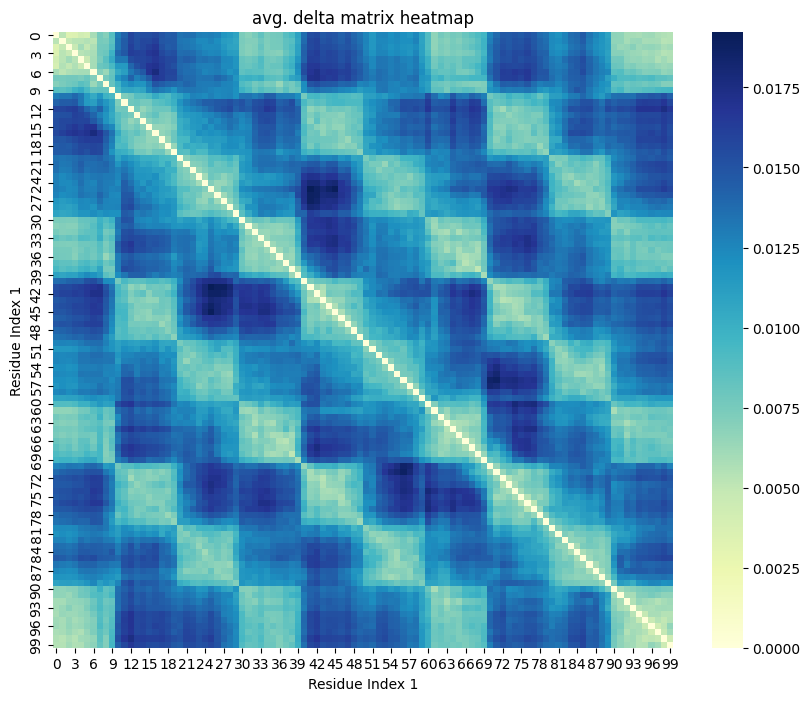

0.8371


In [31]:
res = redpandda_general.main_clustering_general(df, 6)

In [32]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0062


In [33]:
res_hdbscan

(array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 4.128514605908889,
 array([[0.99968977, 0.99977366, 0.99974535, ..., 0.99978236, 0.99978021,
         0.99977725],
        [0.99977366, 0.99968977, 0.99976963, ..., 0.99978513, 0.99977702,
         0.99977751],
        [0.99974535, 0.99976963, 0.99968977, ..., 0.99979167, 0.99978338,
         0.99978724],
        ...,
        [0.99978236, 0.99978513, 0.99979167, ..., 0.99968977, 0.9997693 ,
         0.99978703],
        [0.99978021, 0.99977702, 0.99978338, ..., 0.9997693 , 0.99968977,
         0.99976187],
        [0.99977725, 0.99977751, 0.99978724, ..., 0.99978703, 0.99976187,
         0.99968977]]),
 [array([[ 0],
         [ 1],
         [ 2],
  

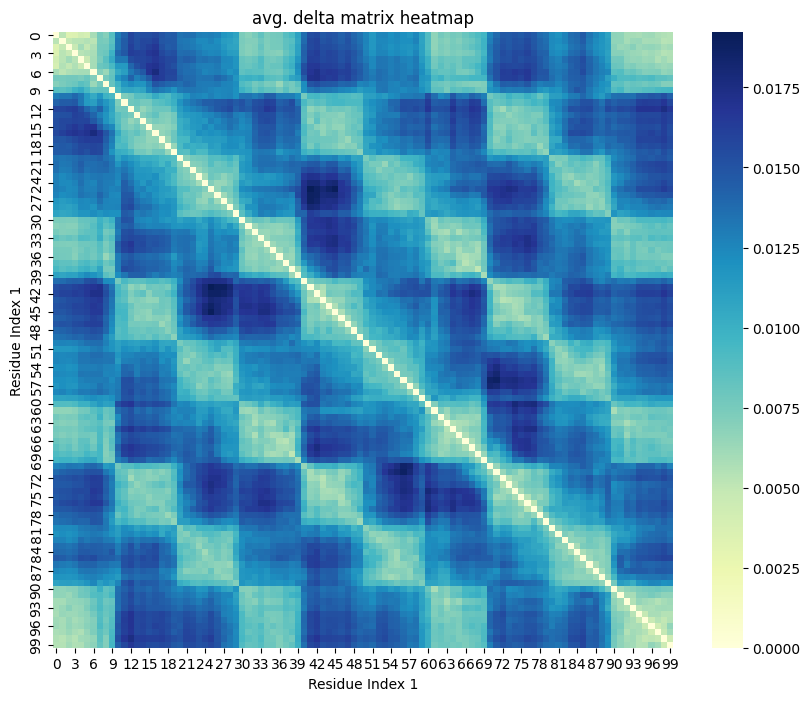

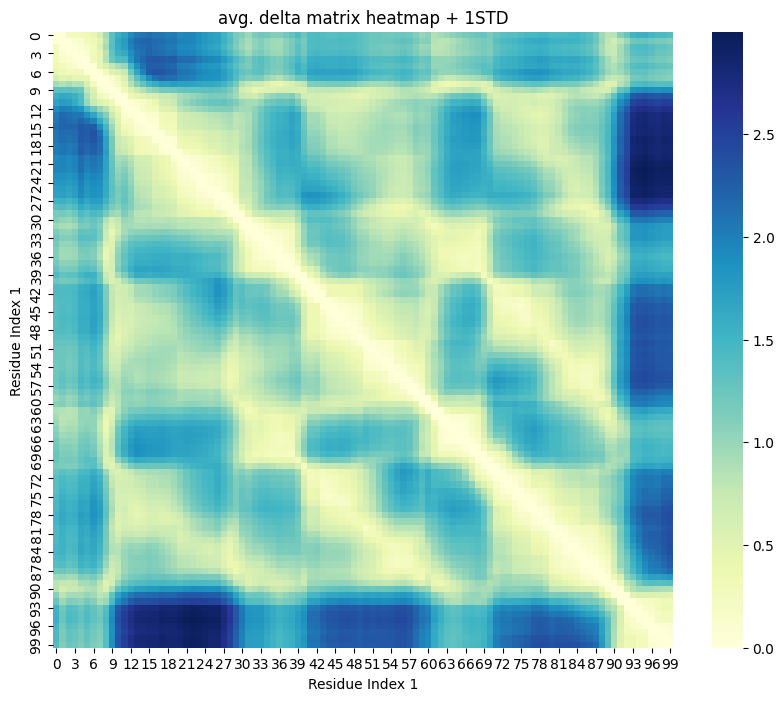

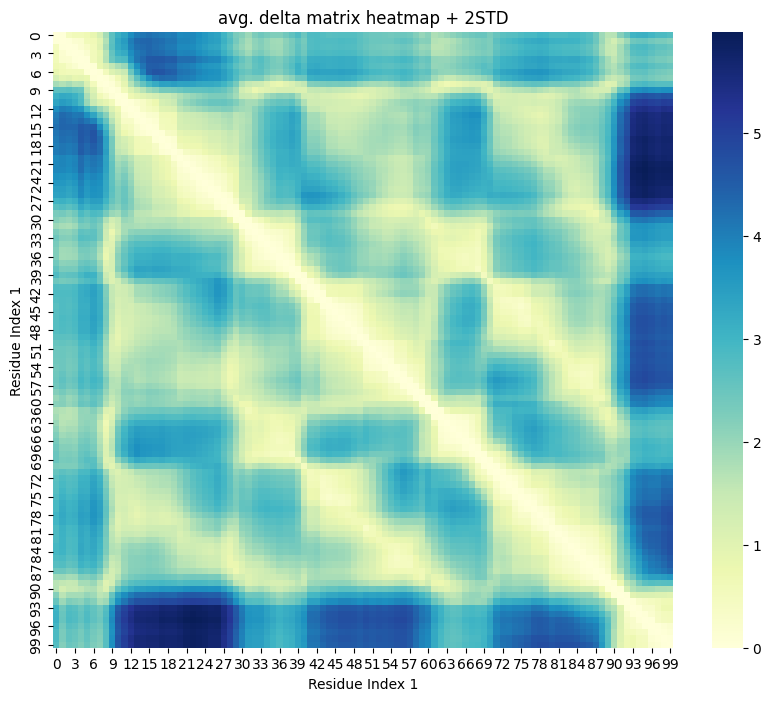

1.8812
something wrong with clustering Q computation


In [34]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

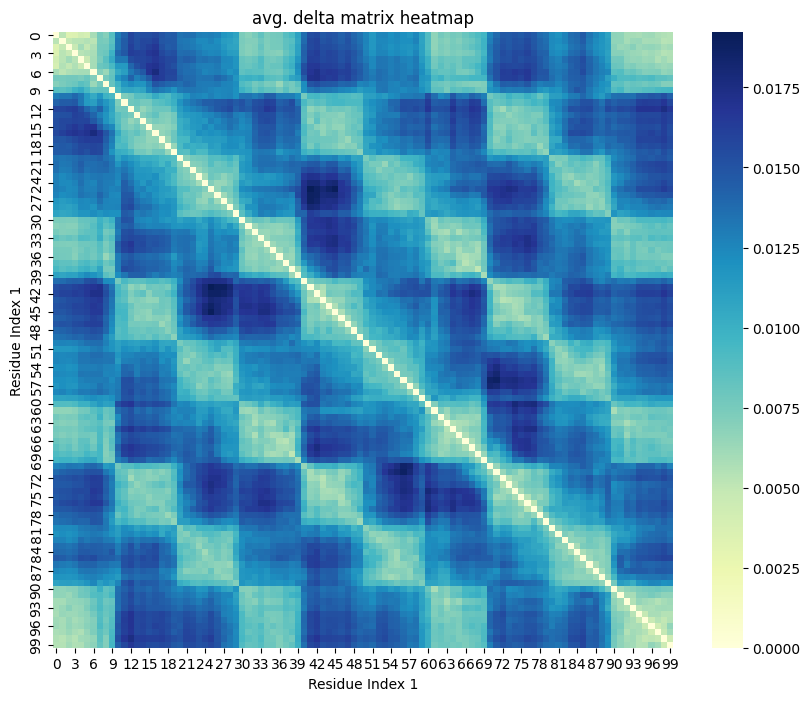

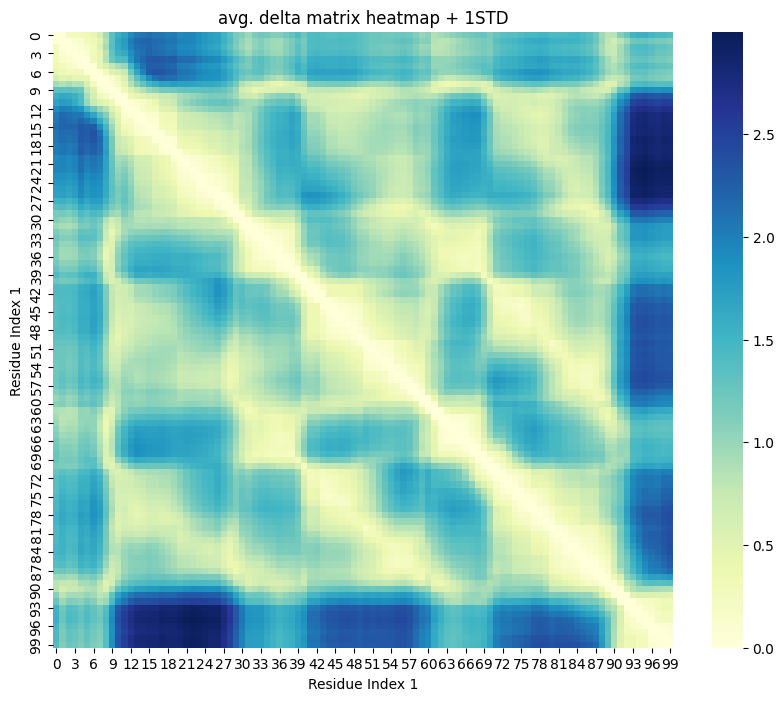

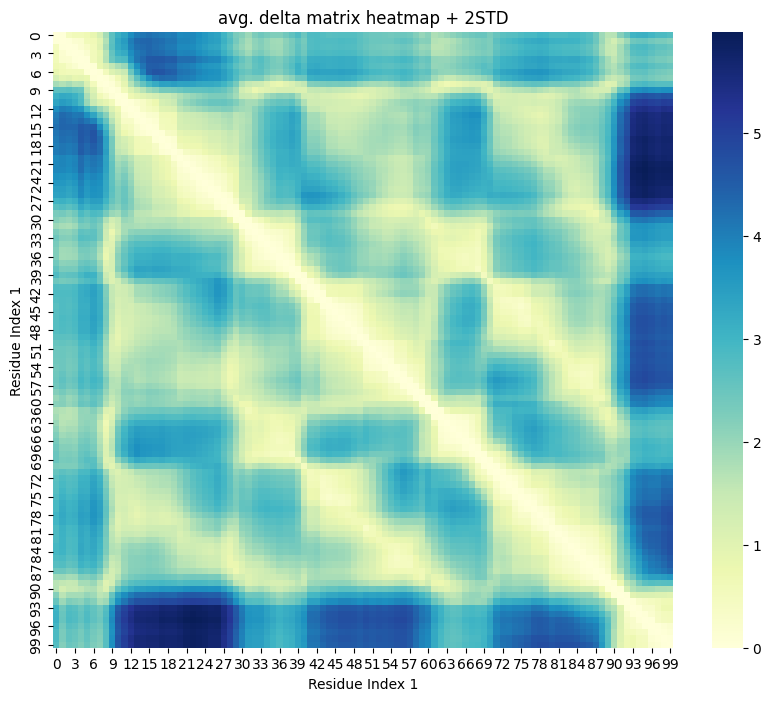

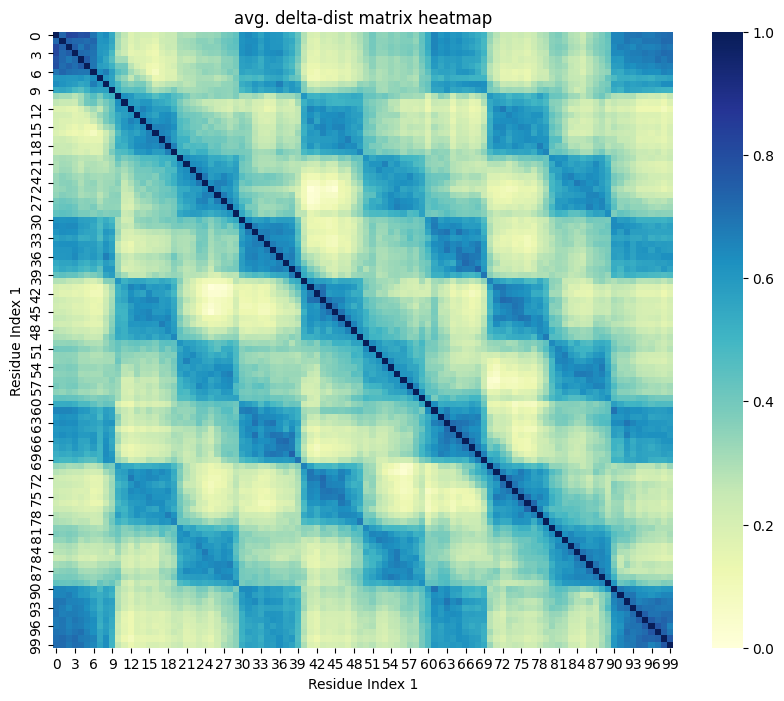

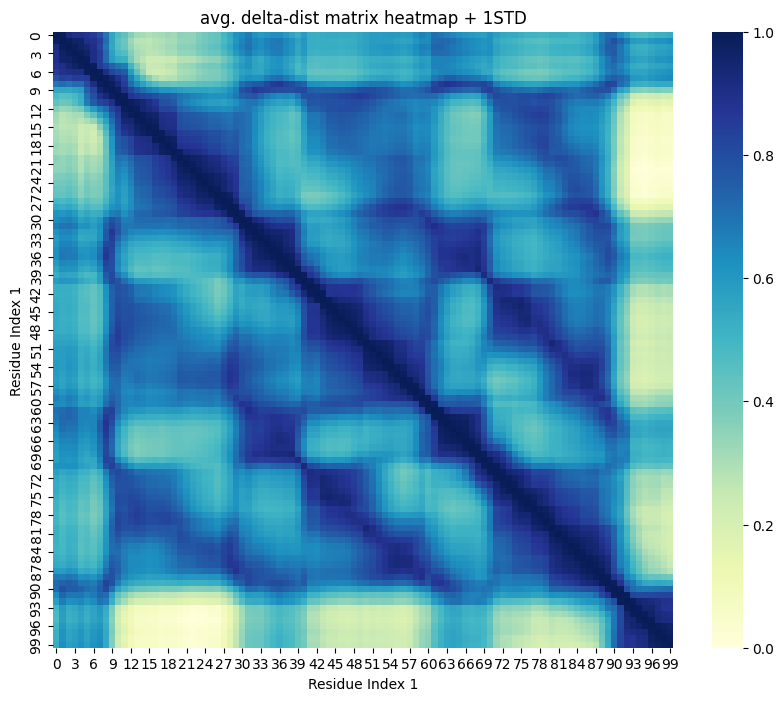

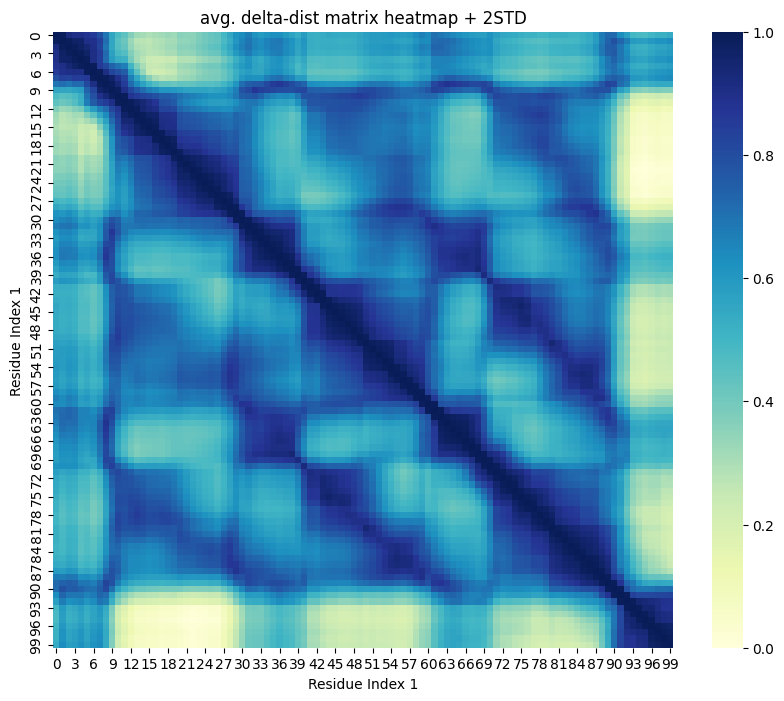

3.8080


In [35]:
res_specvar_distance = redpandda_general.main_clustering_general_std_distance(df, None)

In [36]:
result_labels = res[0]

In [37]:
result_labels

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 0, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [38]:
trajectories_results = []
for ip, particle_traj in enumerate(trajectories):
    trajectory_result = []

    for it, timestep in enumerate(particle_traj):
        trajectory_result.append([*timestep[:-1], result_labels[ip]])
    trajectories_results.append(trajectory_result)

In [39]:
trajectories_results = [
    [[*timestep[:-1], result_labels[ip]] for timestep in particle_traj]
    for ip, particle_traj in enumerate(trajectories)
]

In [40]:
traj_array, point_array, frames_count, n_objects = redpandda_general.prepare_data_from_df(df)

In [41]:
dist_matrices = redpandda_general.get_distance_matrices(traj_array)
delta_matrices = redpandda_general.get_delta_matrices(dist_matrices)
average_delta_matrix = redpandda_general.calculate_average_delta_matrix(delta_matrices)

std_delta_matrix = redpandda_general.get_std_matrices(dist_matrices)

In [42]:
std_delta_matrix

array([[0.        , 0.01863388, 0.23491408, ..., 1.42658258, 1.42758715,
        1.38191706],
       [0.01863388, 0.        , 0.01705157, ..., 1.14689847, 1.14676795,
        1.10680986],
       [0.23491408, 0.01705157, 0.        , ..., 1.30307278, 1.29552469,
        1.25455136],
       ...,
       [1.42658258, 1.14689847, 1.30307278, ..., 0.        , 0.02274761,
        0.05600472],
       [1.42758715, 1.14676795, 1.29552469, ..., 0.02274761, 0.        ,
        0.01762511],
       [1.38191706, 1.10680986, 1.25455136, ..., 0.05600472, 0.01762511,
        0.        ]])

In [43]:
summed_delta_matrix = average_delta_matrix

In [44]:
summed_delta_matrix_1std = summed_delta_matrix + std_delta_matrix 
summed_delta_matrix_2std = summed_delta_matrix + std_delta_matrix * 2

In [45]:
from distance_matrix import *

In [46]:
normed_delta_matrix = 1 - normed_values(summed_delta_matrix)
normed_delta_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

In [47]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)
normed_similarity_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_similarity_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

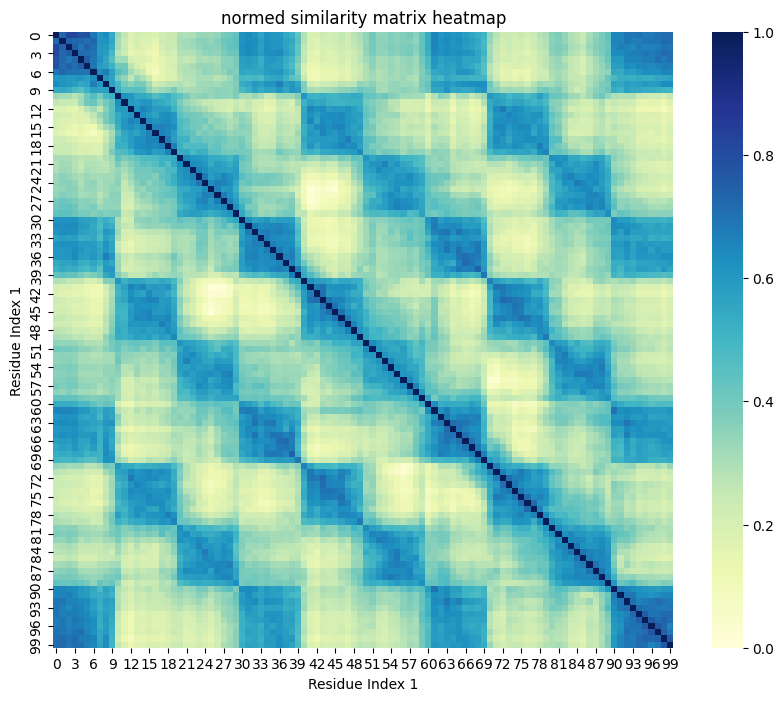

In [48]:
create_delta_heatmap(normed_similarity_matrix, title="normed similarity matrix heatmap")

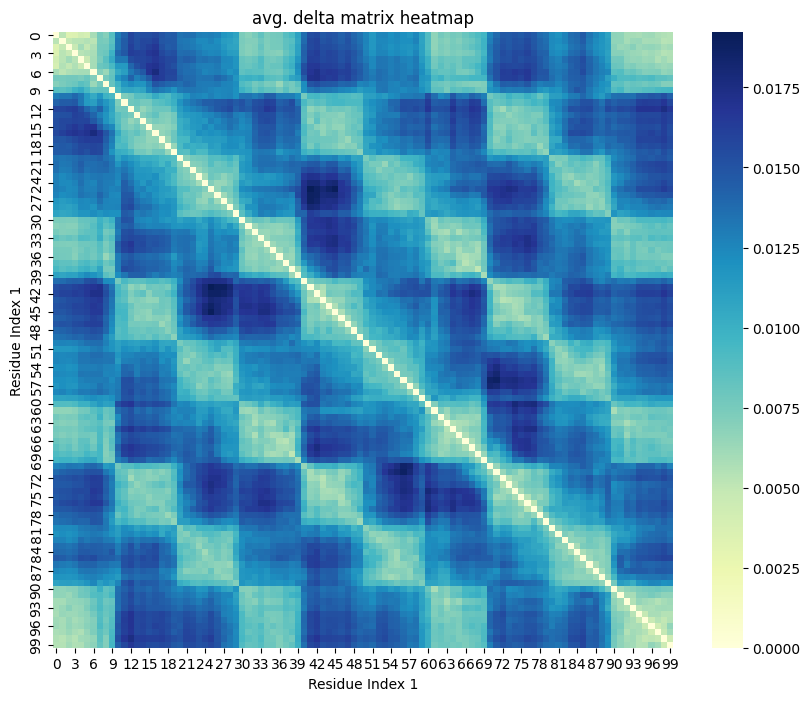

In [49]:
import distance_matrix
distance_matrix.create_delta_heatmap(average_delta_matrix, title="avg. delta matrix heatmap")

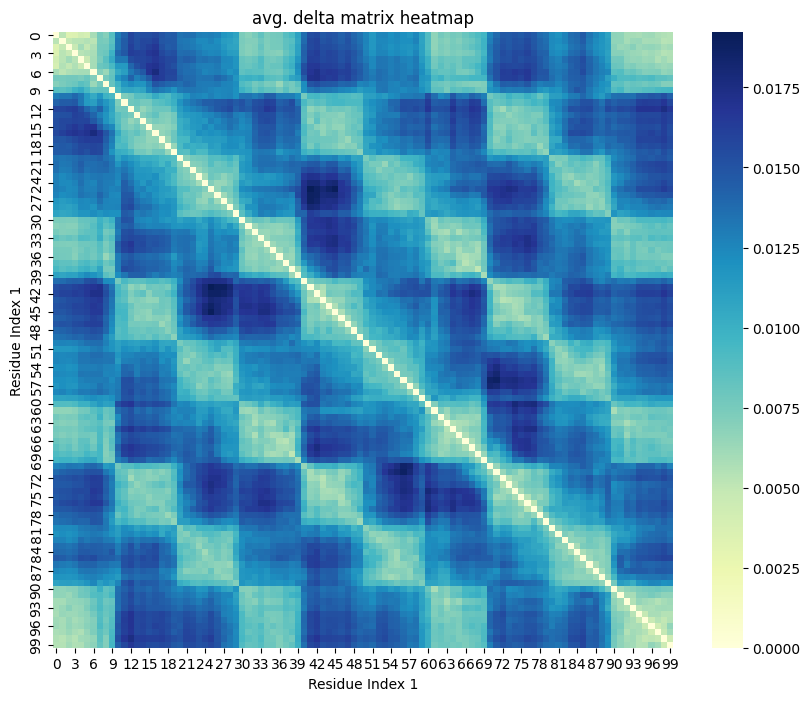

0.8199


array([0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3,
       3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [50]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [51]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(normed_similarity_matrix)

In [52]:
result.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 0, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 2, 2, 2, 2,
       2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5], dtype=int32)

In [53]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[5 5 5 5 0 4 4 4 0 5 5 5 5 4 4 4 4 4 4 0 4 4 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 4 0 0 0 0 0 0 0 0 4 4 4 4 2 3 3 3 3 3 1 1 3 3 1 1 3 2 2 2 2 0 3 1 1 1
 3 3 3 3 3 0 0 0 0 4 4 4 4 4 2 2 2 1 2 1 0 0 0 0 0 0]


In [54]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 0  0  0  0  0  0  0  0  0  0 -1 -1  2  2  2  2  2  2  2  2  1  1  1  1
  1  1  1  1  1  1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2
  2  2  1  1  1  1  1  1  1  1  1 -1  0  0  0  0  0  0  0  0  0  0  2  2
  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  0  0  0  0  0  0
  0  0  0  0]


In [55]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1 -1 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3  3
  3 -1 -1 -1 -1  5  5  5  5  5  5 -1 -1  6  6  6  6  6  6  6  6  7  7  7
  7  7  7  7  7 -1 -1 -1 -1  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4 -1]


In [56]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1 -1 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3
  3  4  4 -1 -1  8  8  8  8  8  8  8 -1  9  9  9  9  9  9  9  9 -1 -1 10
 10 11 11 11 11 -1 -1  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7
  7  7  7 -1]


In [57]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

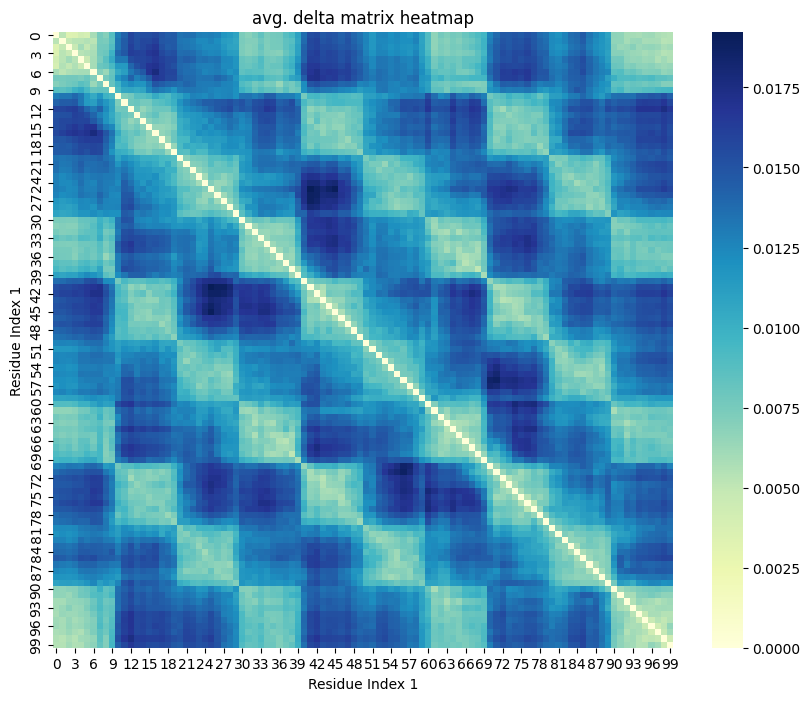

0.6824


array([1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 0, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5,
       5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [58]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [59]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result = clustering.fit(average_delta_matrix)

In [60]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result = clustering.fit(summed_delta_matrix_2std)

In [61]:
result.labels_

array([ 0,  0,  0,  0,  0,  0, 15, 15, 13, 13, 23, 23,  4,  4,  4,  4,  4,
       26, 26, 11, 11,  6,  6,  6,  6,  6,  6, 10, 10, 10, 21, 21, 20, 20,
       20, 20, 20, 20, 19, 19, 22, 22, 24, 24, 18, 18, 18, 18, 18, 18,  1,
        1,  1,  1,  1,  1,  1,  8,  8,  8, 17, 17, 14, 14, 14, 14, 14, 14,
        3,  3,  3,  3,  5,  5,  5,  5,  9,  9,  9,  9,  2,  2,  2,  2,  2,
        2,  2,  2, 25, 25, 16, 16,  7,  7,  7,  7, 12, 12, 12, 12])

In [62]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1 -1 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3
  3  4  4 -1 -1  8  8  8  8  8  8  8 -1  9  9  9  9  9  9  9  9 -1 -1 10
 10 11 11 11 11 -1 -1  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7
  7  7  7 -1]


In [63]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 0  0  0  0  0  0  0  0  0  0 -1 -1  2  2  2  2  2  2  2  2  1  1  1  1
  1  1  1  1  1  1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2
  2  2  1  1  1  1  1  1  1  1  1 -1  0  0  0  0  0  0  0  0  0  0  2  2
  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  0  0  0  0  0  0
  0  0  0  0]


In [64]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(normed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1 -1 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3
  3  4  4 -1 -1  8  8  8  8  8  8  8 -1  9  9  9  9  9  9  9  9 -1 -1 10
 10 11 11 11 11 -1 -1  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7
  7  7  7 -1]


In [65]:
#FF

In [66]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6 = clustering.fit(normed_similarity_matrix)

clustering = SpectralClustering(n_clusters=3, affinity='precomputed')
result_spectral_3 = clustering.fit(normed_similarity_matrix)

In [67]:
clustering = SpectralClustering(n_clusters=4, affinity='precomputed')
result_spectral_4 = clustering.fit(normed_similarity_matrix)

In [68]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)

In [69]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 0, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 0, 5, 5, 1, 1, 1, 1,
       1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4])

In [70]:
clustering = SpectralClustering(n_clusters=3, affinity='precomputed', assign_labels="discretize")
result_spectral_3_discr = clustering.fit(normed_similarity_matrix)
result_spectral_3_discr.labels_

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [71]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="cluster_qr")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 1, 1, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3])

In [72]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

In [73]:
result_spectral_3.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [74]:
result_spectral_6.labels_

array([3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 0, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 4, 4, 4, 4,
       4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], dtype=int32)

In [75]:
result_spectral_6_discr.labels_

array([1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

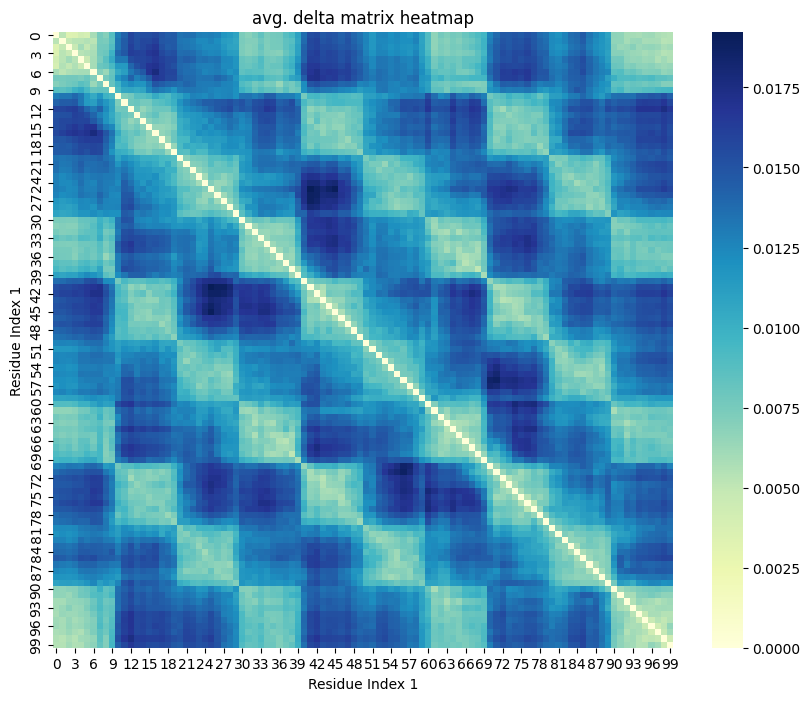

0.7424


array([3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3])

In [76]:
distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, 6)

In [77]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)


In [78]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[0 1 0 0 0 4 4 4 5 0 0 0 0 4 4 4 4 4 4 0 4 0 0 0 0 0 5 5 5 5 5 5 5 5 5 0 1
 0 4 4 5 5 5 5 5 5 5 5 4 4 4 4 0 3 3 3 3 3 3 0 3 3 3 3 0 2 2 2 2 1 3 3 3 3
 3 3 3 3 3 1 1 1 1 4 4 4 4 4 2 2 2 0 0 0 0 0 0 0 1 1]


In [79]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result_hdbscan_4_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_4_2.labels_)

[ 0  0  0  0  0  0  0  0  0  0 -1 -1  2  2  2  2  2  2  2  2  1  1  1  1
  1  1  1  1  1  1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2
  2  2  1  1  1  1  1  1  1  1  1 -1  0  0  0  0  0  0  0  0  0  0  2  2
  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  0  0  0  0  0  0
  0  0  0  0]


In [80]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result_hdbscan_4_2_1std = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result_hdbscan_4_2_1std.labels_)

[-1  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1 -1 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3  3
  3 -1 -1 -1 -1  5  5  5  5  5  5 -1 -1  6  6  6  6  6  6  6  6  7  7  7
  7  7  7  7  7 -1 -1 -1 -1  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4 -1]


In [81]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2_2std = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result_hdbscan_2_2_2std.labels_)

[-1  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1 -1 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3
  3  4  4 -1 -1  8  8  8  8  8  8  8 -1  9  9  9  9  9  9  9  9 -1 -1 10
 10 11 11 11 11 -1 -1  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7
  7  7  7 -1]


In [82]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

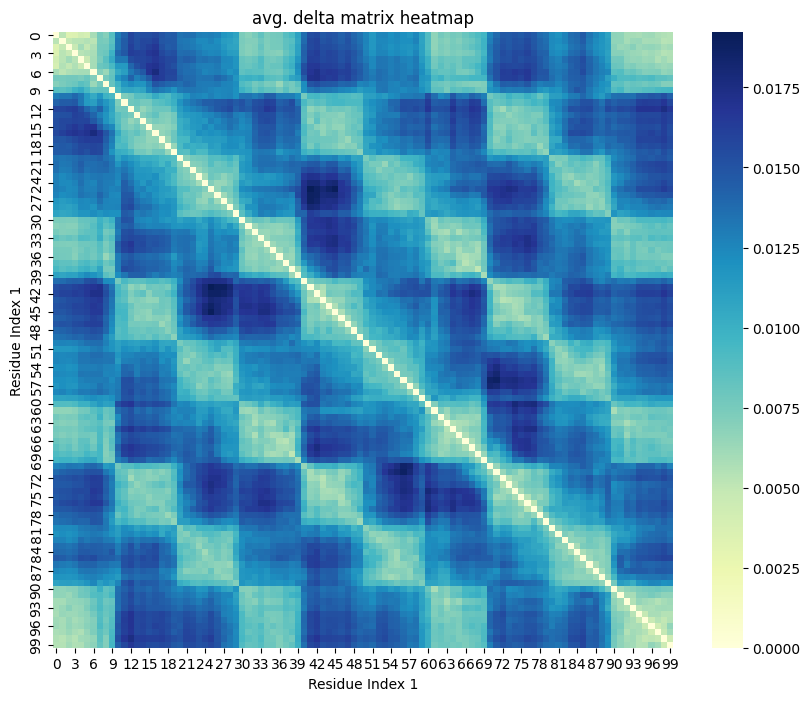

0.7540


array([0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 2, 2, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 3, 3, 3, 3,
       3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [83]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [84]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result_agglo_compl_dt01 = clustering.fit(average_delta_matrix)

In [85]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result_agglo_compl_dt07_2std  = clustering.fit(summed_delta_matrix_2std)

In [86]:

clustering = AgglomerativeClustering(n_clusters=3, metric='precomputed', linkage='complete')

result_agglo_cl3  = clustering.fit(average_delta_matrix)

In [87]:
result_agglo_compl_dt01.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [88]:
result_agglo_cl3.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [89]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_2_2.labels_)

[ 0  0  0  0  0  0  0  0  0  0 -1 -1  2  2  2  2  2  2  2  2  1  1  1  1
  1  1  1  1  1  1  0  0  0  0  0  0  0  0  0  0  2  2  2  2  2  2  2  2
  2  2  1  1  1  1  1  1  1  1  1 -1  0  0  0  0  0  0  0  0  0  0  2  2
  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  0  0  0  0  0  0
  0  0  0  0]


In [90]:
result_hdbscan_2_2_2std.labels_

array([-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,
        1,  1, -1, -1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,
       -1, -1,  8,  8,  8,  8,  8,  8,  8, -1,  9,  9,  9,  9,  9,  9,  9,
        9, -1, -1, 10, 10, 11, 11, 11, 11, -1, -1,  5,  5,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7, -1])

In [91]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [92]:
true_labels = groups_list[:,0]

In [93]:
true_labels

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [94]:
residue_items = list(range(len(true_labels)))

In [95]:
import visualizations


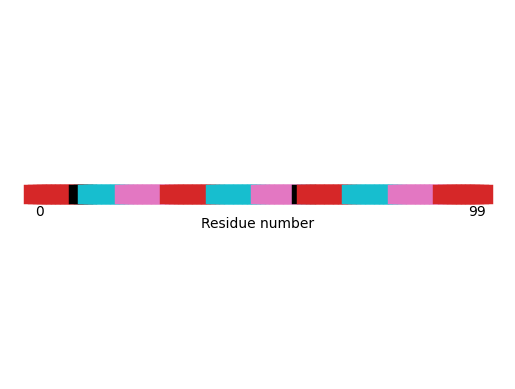

In [96]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

In [97]:
from sklearn.cluster import AffinityPropagation

In [98]:
clustering_aff = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix.astype(np.float64))
clustering_aff_1std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_1std.astype(np.float64))
clustering_aff_2std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_2std.astype(np.float64))

In [99]:
clustering.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1,  2,  2,  2,  2,  2,
        2,  2,  2,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  1,
        1,  1,  1,  1,  1,  1,  1,  1, -1,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])

In [100]:
clustering_aff_1std.labels_

array([ 0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  8,  4,  4,  4,
        4,  4,  4,  4,  4,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  9,  9,  9,  9,  9,  9,
        9,  4,  5, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11,
       11, 11, 11, 11, 11, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13])

In [101]:
clustering_aff_2std.labels_

array([ 0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  8,  4,  4,  4,
        4,  4,  4,  4,  4,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  9,  9,  9,  9,  9,  9,
        9,  4,  5, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11,
       11, 11, 11, 11, 11, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13])

In [102]:
res_hdbscan_2_1 = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0157


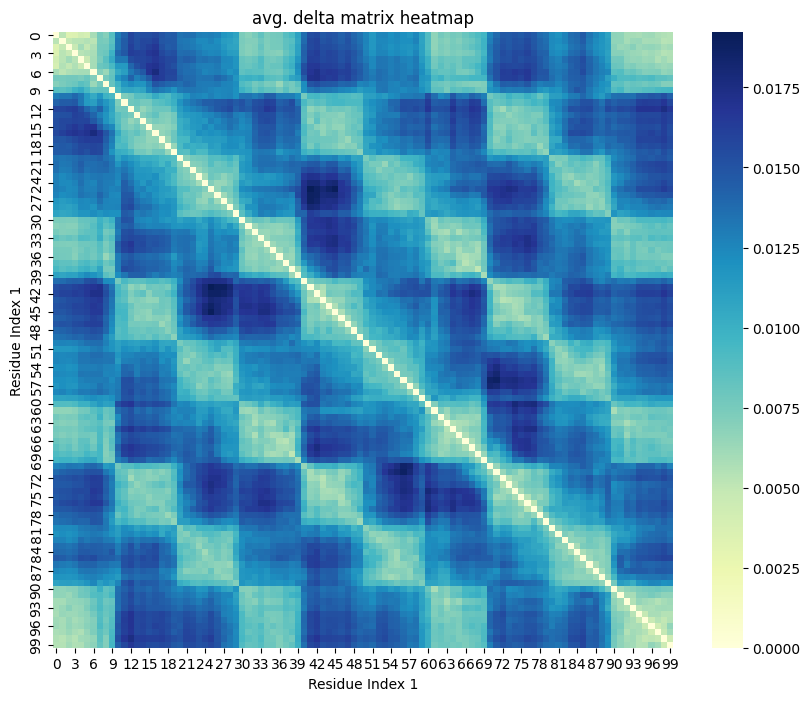

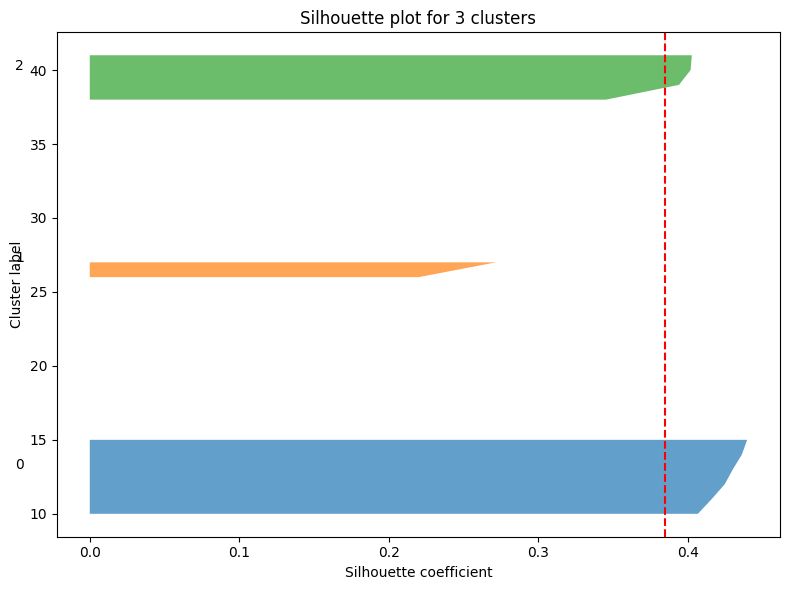

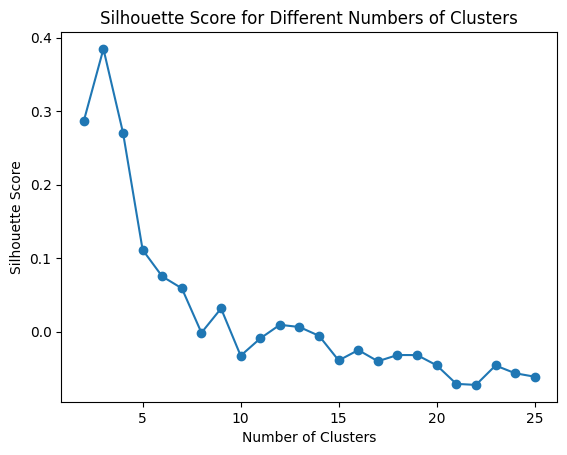

1.5218


In [103]:
spectral_opt_sil = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, cluster_count=None, silhouette = True)
spectral_opt_sil = list(spectral_opt_sil)


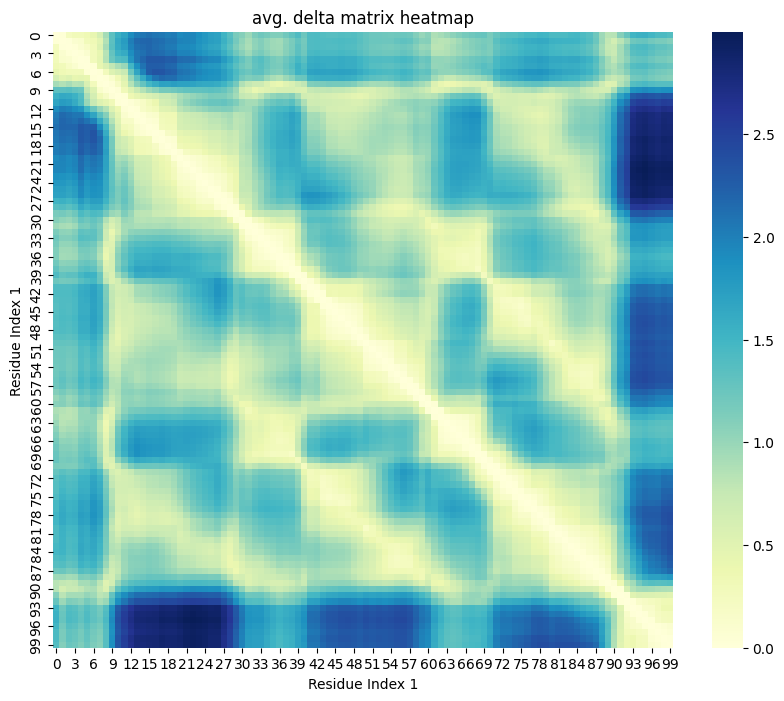

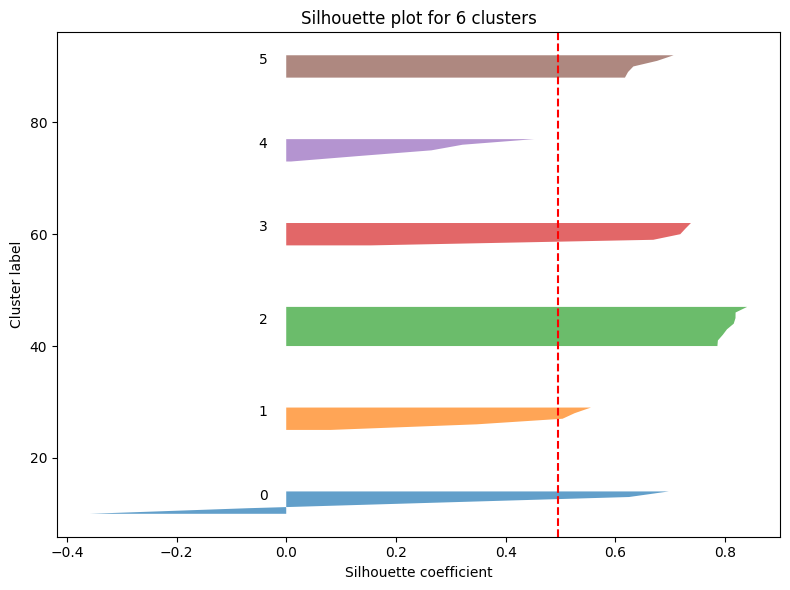

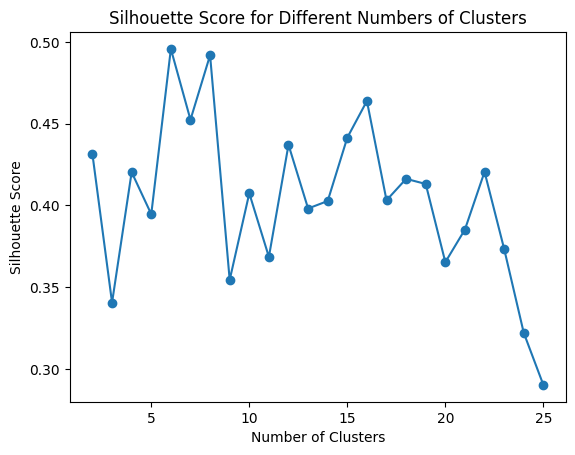

1.1757


In [104]:
spectral_opt_sil_1std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_1std, cluster_count=None, silhouette = True)
spectral_opt_sil_1std = list(spectral_opt_sil_1std)

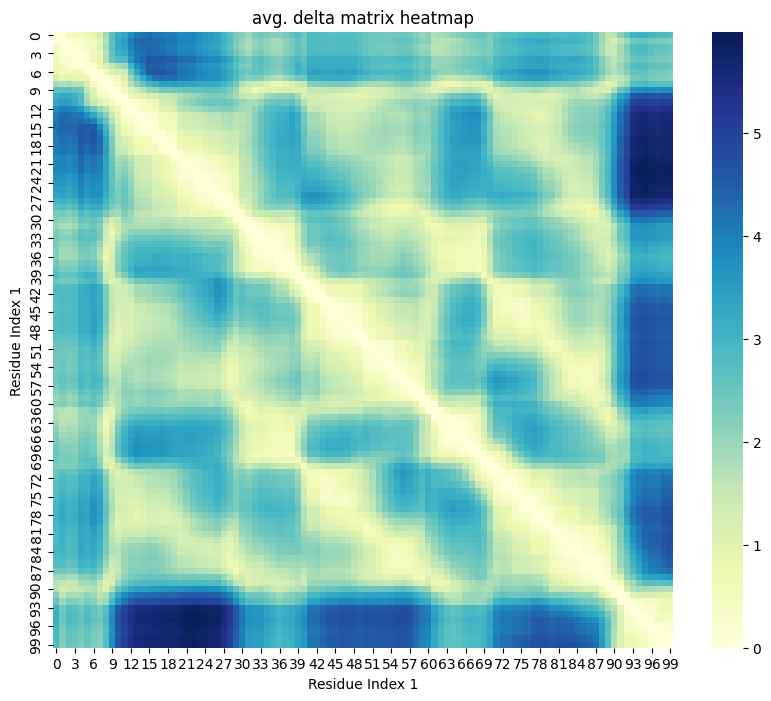

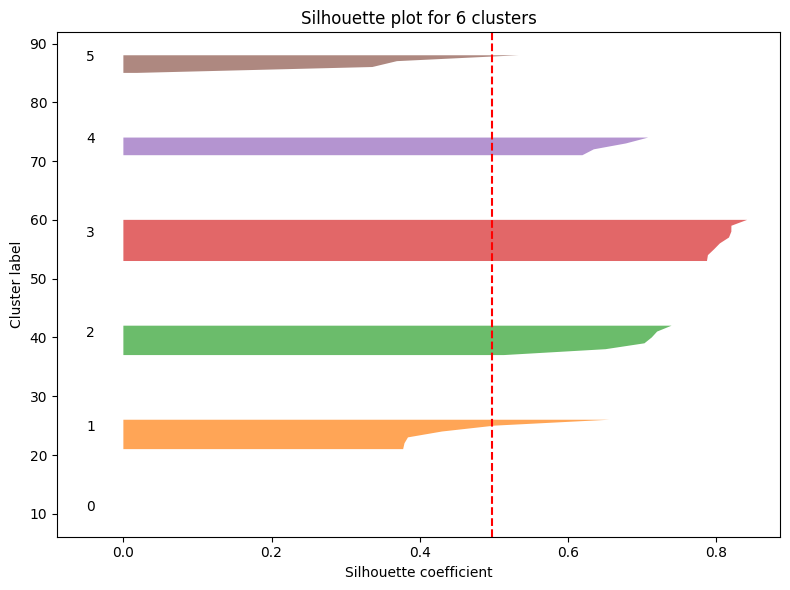

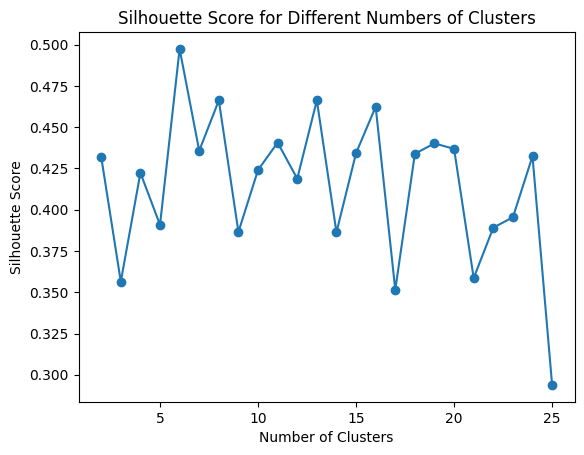

1.2623


In [105]:
spectral_opt_sil_2std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_2std, cluster_count=None, silhouette = True)
spectral_opt_sil_2std = list(spectral_opt_sil_2std)

In [106]:
clustering_names = []
clustering_results = []

clustering_names.append("hdbscan, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2_1[0]))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2std[0]))

clustering_names.append("hdbscan, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2.labels_))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2_2std.labels_))
clustering_names.append("hdbscan, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2.labels_))
clustering_names.append("hdbscan, +1std, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2_1std.labels_))



clustering_names.append("spectral,  clusters:6")
clustering_results.append(list(result_spectral_6.labels_))
clustering_names.append("spectral,  clusters:3")
clustering_results.append(list(result_spectral_3.labels_))
clustering_names.append("spectral,  clusters:4")
clustering_results.append(list(result_spectral_4.labels_))

clustering_names.append("affinity prop")
clustering_results.append(list(clustering_aff.labels_))
clustering_names.append("affinity prop, +1std")
clustering_results.append(list(clustering_aff_1std.labels_))
clustering_names.append("affinity prop, +2std")
clustering_results.append(list(clustering_aff_2std.labels_))

clustering_names.append("spectra, opt.silh.")
clustering_results.append(list(spectral_opt_sil))
clustering_names.append("spectra, opt.silh., +1std")
clustering_results.append(list(spectral_opt_sil_1std))
clustering_names.append("spectra, opt.silh., +2std")
clustering_results.append(list(spectral_opt_sil_2std))





In [107]:
import numpy as np
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix

def evaluate_clustering_nr_wrong_elements(true_labels, predicted_labels):

    cm = confusion_matrix(true_labels, predicted_labels)
    
    # Hungarian / Munkres algorithm
    row_ind, col_ind = linear_sum_assignment(-cm)
    
    correctly_clustered = cm[row_ind, col_ind].sum()
    
    total_items = len(true_labels)
    wrongly_clustered = total_items - correctly_clustered
    
    return wrongly_clustered

In [108]:
traj_array = np.array(trajectories)[:,:,:-1]

In [109]:
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [110]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))


In [111]:
result_hdbscan_2_2_flat.labels_


array([-1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2, -1, -1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  1,  1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1])

In [112]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)

In [113]:
result_spectral_3_flat.labels_

array([2, 0, 0, 1, 1, 1, 0, 0, 1, 2, 0, 1, 0, 2, 1, 0, 1, 1, 0, 2, 1, 1,
       1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 0, 0, 1, 1, 1, 1, 1, 2, 1, 1,
       2, 0, 1, 0, 0, 1, 1, 1, 1, 1, 2, 2, 0, 1, 0, 0, 1, 2, 1, 1, 1, 1,
       2, 2, 1, 0, 1, 1, 0, 1, 1, 1, 1, 2, 1, 0, 2, 1, 2, 1, 1, 0, 0, 2,
       0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 2], dtype=int32)

In [114]:
#vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)

In [115]:
def compute_velocities(points, delta_t=1):

    velocities = []
    
    for point_series in points:
        point_velocities = []
        for i in range(1, len(point_series)):
            velocity = [(point_series[i][j] - point_series[i-1][j]) / delta_t for j in range(3)]
            point_velocities.append(velocity)
        
        #let's assume starting velocity is 0
        point_velocities.insert(0, [0.0, 0.0, 0.0])
        velocities.append(point_velocities)
    
    return velocities

    
try:
    vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)
    traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
    flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

except:
    print("no simulation data with velocities")
    traj_array_vel = compute_velocities(traj_array)
    traj_array_vel = np.array(traj_array_vel)
    flattened_array_vel =  traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [116]:
traj_array = np.array(trajectories)[:,:,:-1]
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [117]:
#traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
#flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [118]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)
result_spectral_3_flat.labels_

array([2, 1, 0, 1, 1, 1, 2, 1, 1, 0, 1, 1, 0, 2, 1, 1, 2, 2, 2, 0, 1, 1,
       1, 0, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 1, 2, 2, 2, 1, 1,
       2, 1, 0, 2, 1, 2, 1, 2, 0, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 0, 2, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 0, 1, 2, 2, 2, 2, 2, 1,
       1, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2], dtype=int32)

In [119]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat = clustering.fit(flattened_array)
result_spectral_4_flat.labels_

array([3, 0, 1, 3, 2, 1, 3, 0, 3, 2, 0, 2, 1, 3, 3, 0, 3, 0, 0, 3, 1, 2,
       2, 0, 3, 1, 2, 1, 1, 0, 3, 2, 0, 1, 0, 3, 2, 2, 2, 1, 1, 0, 0, 2,
       3, 1, 3, 1, 0, 0, 3, 3, 3, 2, 3, 2, 1, 2, 2, 3, 0, 2, 3, 0, 1, 3,
       1, 2, 3, 3, 0, 0, 3, 2, 0, 1, 1, 1, 1, 2, 0, 0, 3, 1, 3, 3, 1, 2,
       1, 3, 3, 3, 3, 0, 3, 3, 2, 3, 1, 2], dtype=int32)

In [120]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_3_flat_vel.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [121]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_4_flat_vel.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [122]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

array([-1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2, -1, -1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  1,  1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1])

In [123]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=1) 


result_hdbscan_2_1_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_1_flat_vel.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [124]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [125]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

clustering_names.append("hdbscan, flattened positions, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat.labels_))

In [126]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

clustering_names.append("hdbscan, flattened velocities, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat_vel.labels_))

In [127]:

clustering_names.append("ground truth")
clustering_results.append(list(true_labels))

In [128]:
result_hdbscan_2_2.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1,  2,  2,  2,  2,  2,
        2,  2,  2,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  1,
        1,  1,  1,  1,  1,  1,  1,  1, -1,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])

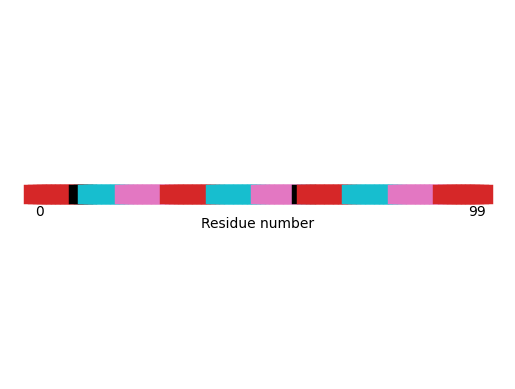

In [129]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

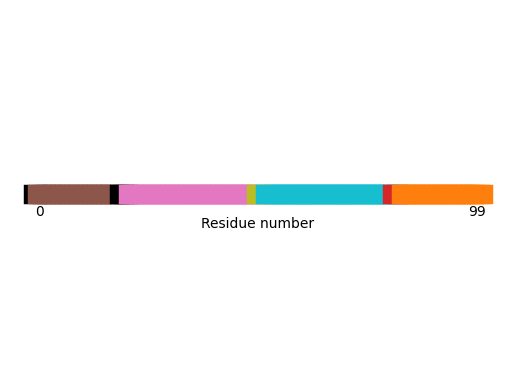

In [130]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2_flat.labels_)

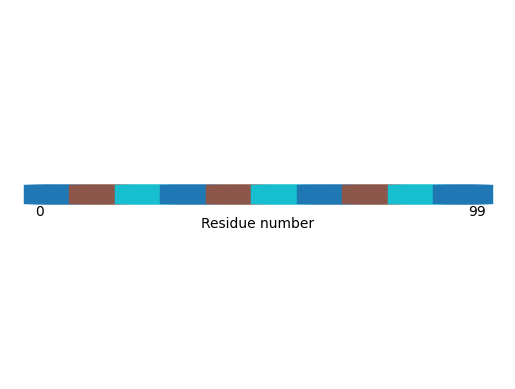

In [131]:
visualizations.plot_residue_line_plus_noise(residue_items, result_spectral_3.labels_)

In [132]:
import sklearn 
def get_clustering_similarity_true(true_clustering, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clustering, clusterings[i])
        sim_results.append(sim_result)
    return sim_results

def get_clustering_similarity_true_trajectories(true_clusterings, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clusterings[i], clusterings[i])
        sim_results.append(sim_result)
    return sim_result



Text(0.5, 1.0, 'adjusted rand score')

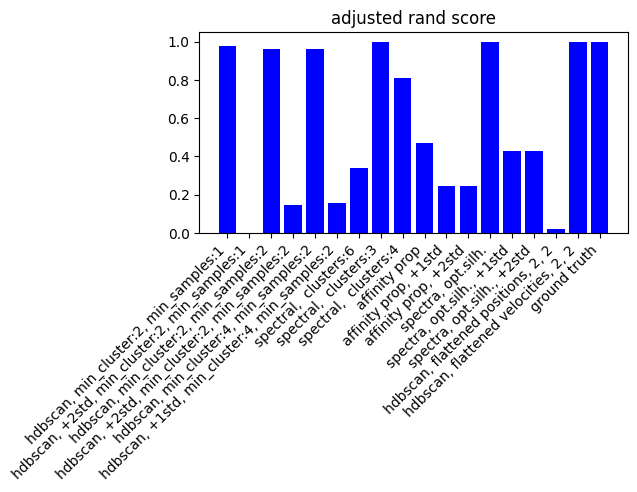

In [133]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("adjusted rand score")

Text(0.5, 1.0, 'nr. of wrong elements')

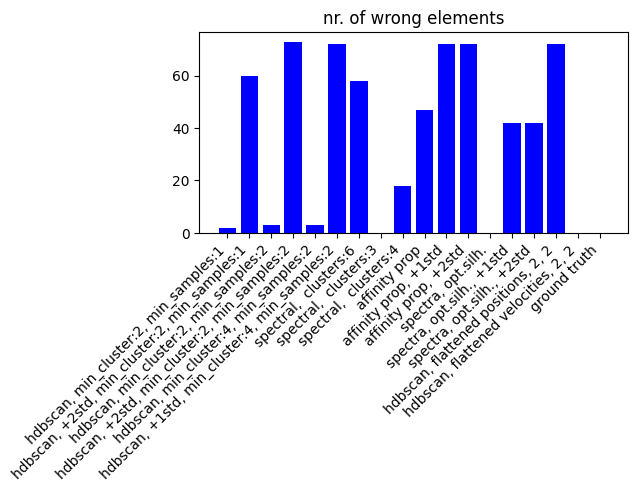

In [134]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, evaluate_clustering_nr_wrong_elements)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("nr. of wrong elements")

Text(0.5, 1.0, 'NMI')

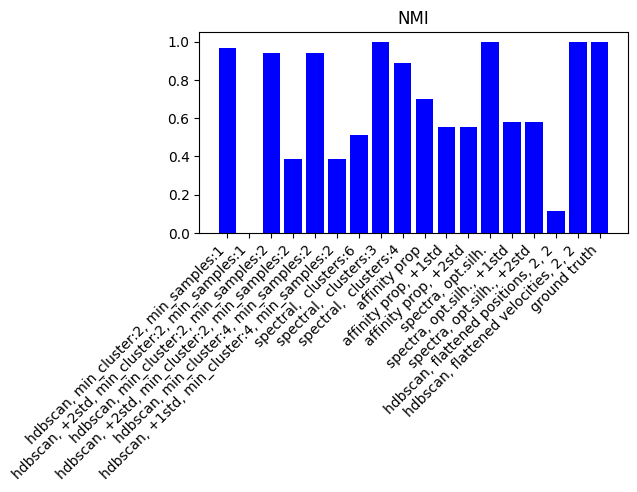

In [135]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, sklearn.metrics.normalized_mutual_info_score)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("NMI")

Text(0.5, 1.0, 'number of points class. as noise')

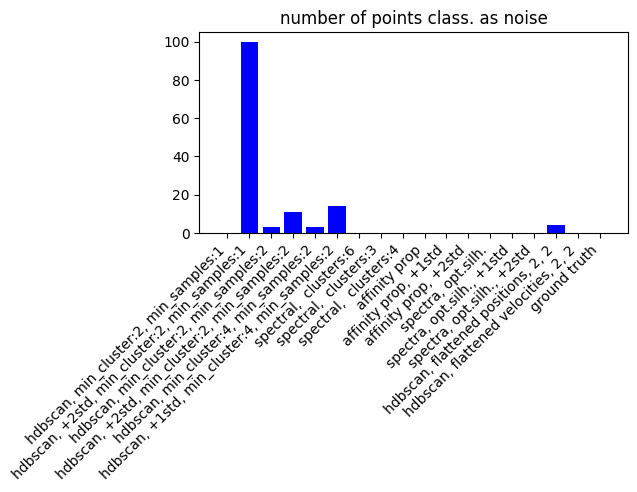

In [136]:
noise_elements = []
noise_int = -1
for res in clustering_results:
    noise_el = len(np.where(np.array(res)==noise_int)[0])
    noise_elements.append(noise_el)

plt.bar(clustering_names, noise_elements, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of points class. as noise")

Text(0.5, 1.0, 'number of clusters')

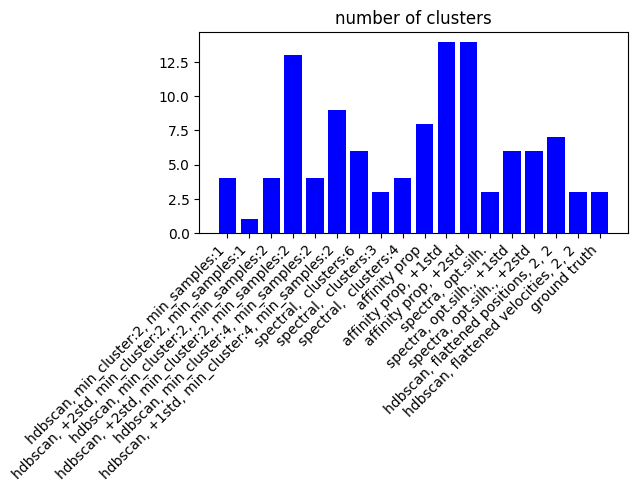

In [137]:

plt.bar(clustering_names, [len(np.unique(x)) for x in clustering_results], color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of clusters")

In [138]:
#Q calculations

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from distance matrices, full, thinning=500')

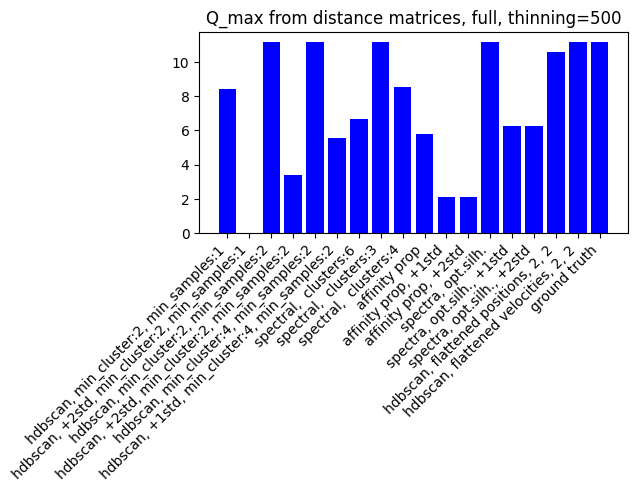

In [139]:
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full, thinning=500")

In [140]:
'''
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full")
'''

'\nQs = []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qs.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qs, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_max from distance matrices, full")\n'

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from distance matrices, full, thinning 500')

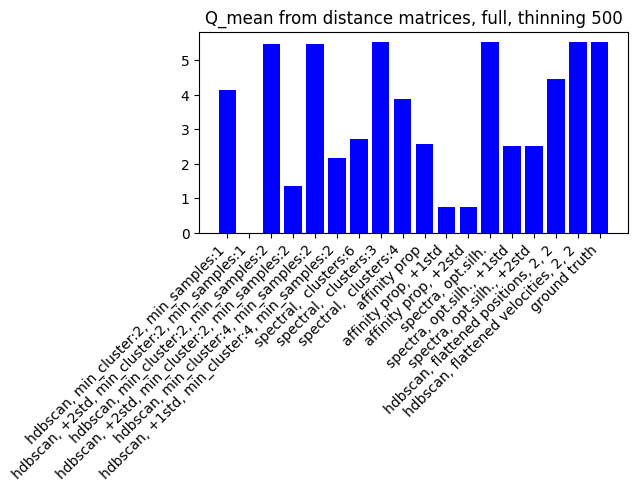

In [141]:
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full, thinning 500")

In [142]:
'''
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full")
'''

'\nQsf3= []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qsf3.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qsf3, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_mean from distance matrices, full")\n'

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from positions, Kabsch superimposition, full, thinning=100')

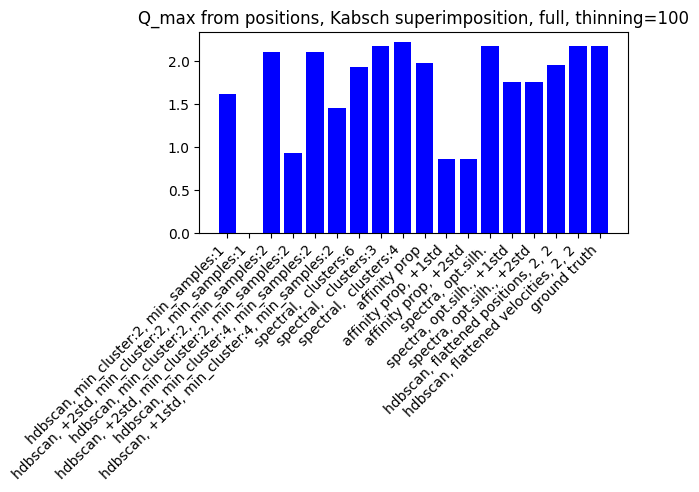

In [143]:

Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=True, apply_superimposition = "kabsch", thinning_factor=100, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from positions, Kabsch superimposition, full, thinning=100")

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from positions, Kabsch superimposition, full, thinning 50')

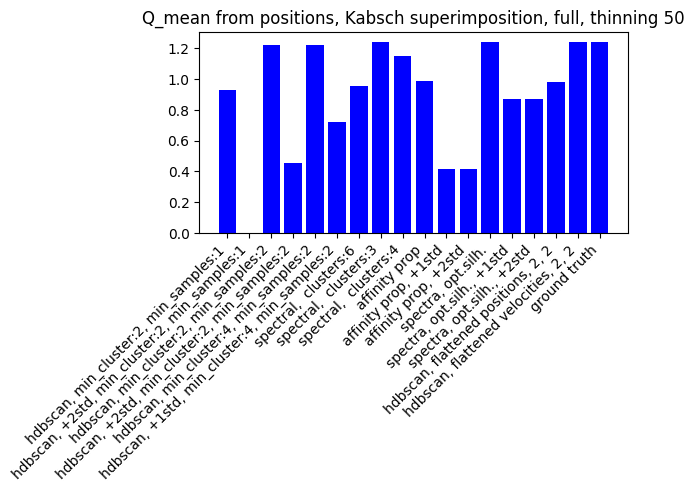

In [144]:
Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=False, apply_superimposition = "kabsch", thinning_factor=50, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from positions, Kabsch superimposition, full, thinning 50")

In [145]:
#q computation fuer verschiedene cluster

In [146]:
import compare_clusterings
import numpy as np
from itertools import combinations

In [147]:
from compare_clusterings import *
from manipulate_trajectory import thin_trajectory

In [148]:
clustering_results

[[1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
 

In [149]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

clustering contains noise
clustering contains noise


clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


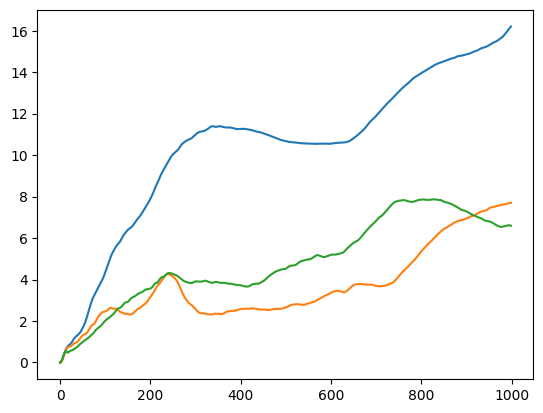

In [150]:
current_clustering = np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')])
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)

for qt in qtraj_dist:
    plt.plot(qt)

In [151]:
current_clustering = np.array(clustering_results[clustering_names.index('ground truth')])

In [152]:
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)



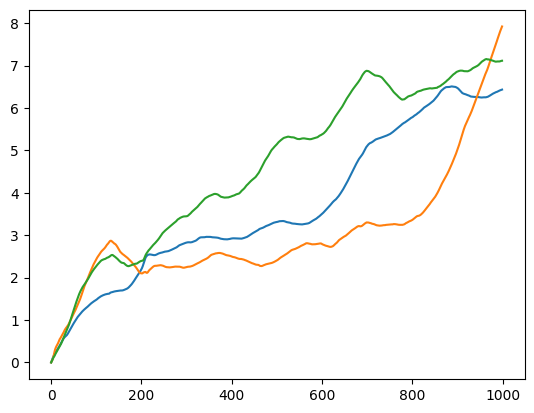

In [153]:
for qt in qtraj_nosup:
    plt.plot(qt)

Text(0.5, 1.0, 'RMSD from positions, centered, reference_frame=0')

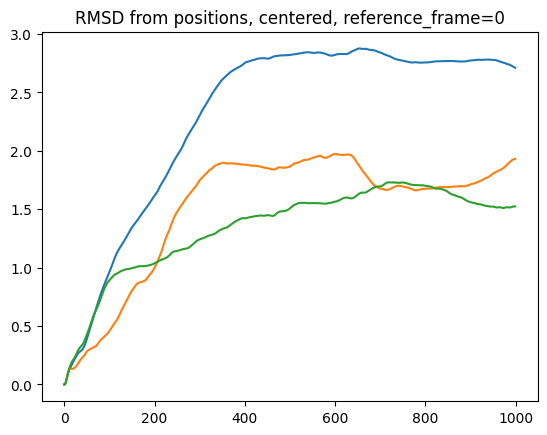

In [154]:
%matplotlib inline
for qt in qtraj_center:
    plt.plot(qt)
plt.title("RMSD from positions, centered, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Kabsch, reference_frame=0')

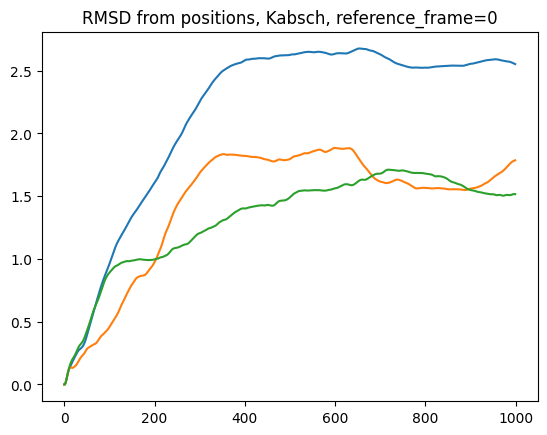

In [155]:
for qt in qtraj_kabsch:
    plt.plot(qt)
plt.title("RMSD from positions, Kabsch, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Procrustes, reference_frame=0')

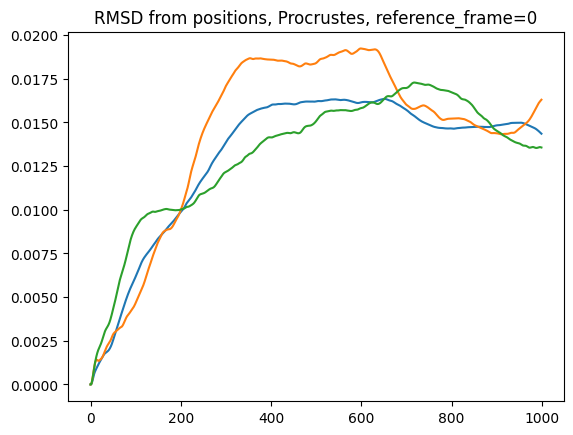

In [156]:
for qt in qtraj_procrustes:
    plt.plot(qt)
plt.title("RMSD from positions, Procrustes, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, reference_frame=0')

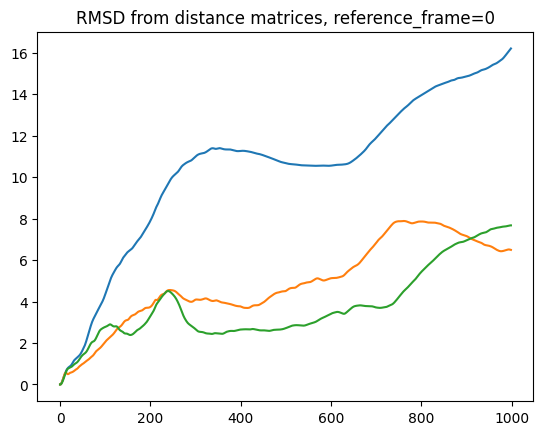

In [157]:
for qt in qtraj_dist:
    plt.plot(qt)
plt.title("RMSD from distance matrices, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, adjacent frames')

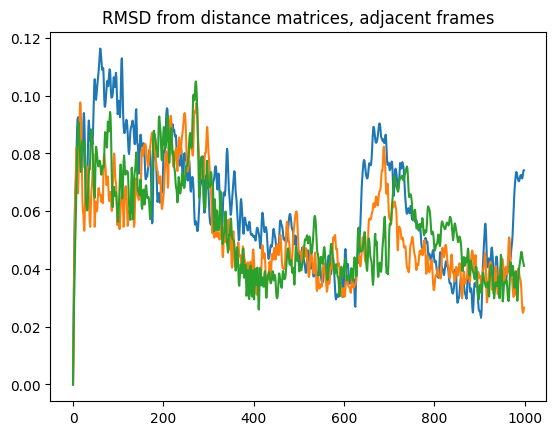

In [158]:
for qt in qtraj_dist_adj:
    plt.plot(qt)
plt.title("RMSD from distance matrices, adjacent frames")

In [159]:
clustering_results

[[1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
 

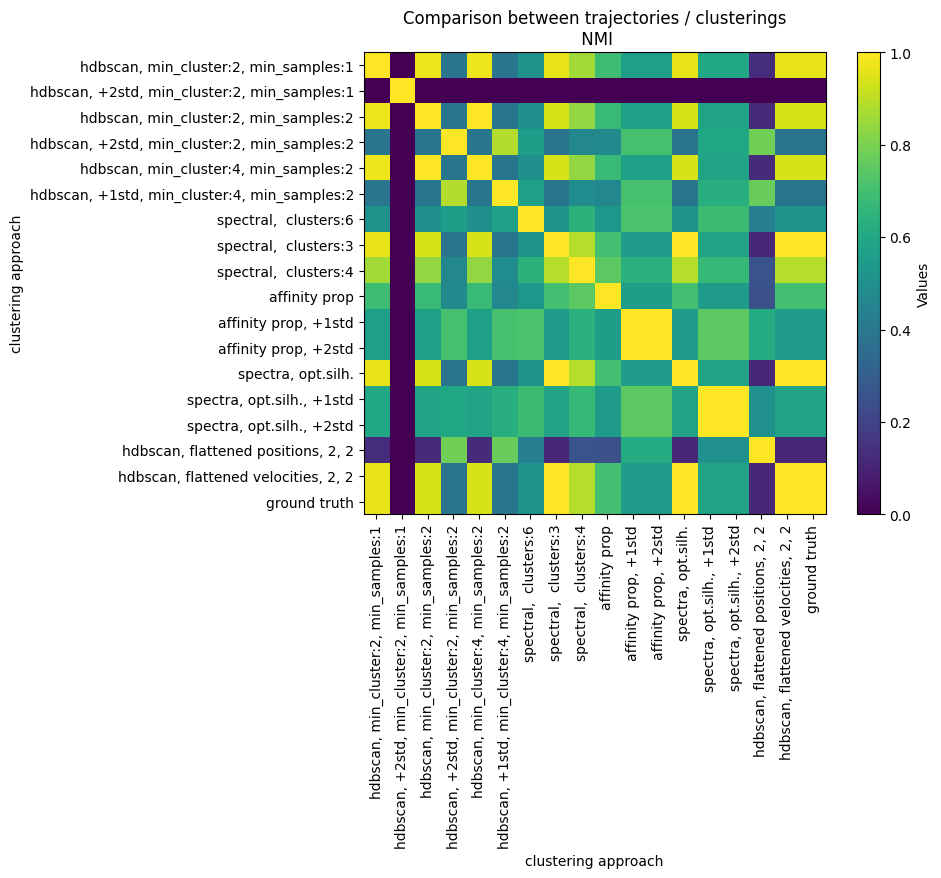

[[0, 0, 1.0],
 [0, 1, 0.0],
 [0, 2, 0.9732118795291256],
 [0, 3, 0.3937726146949092],
 [0, 4, 0.9732118795291256],
 [0, 5, 0.39425300252398204],
 [0, 6, 0.514402904665475],
 [0, 7, 0.9673612158308984],
 [0, 8, 0.861971195840504],
 [0, 9, 0.6900384919911724],
 [0, 10, 0.5644270317966357],
 [0, 11, 0.5644270317966357],
 [0, 12, 0.9673612158308984],
 [0, 13, 0.6004775526945294],
 [0, 14, 0.6004775526945294],
 [0, 15, 0.13056437293418385],
 [0, 16, 0.9673612158308984],
 [0, 17, 0.9673612158308984],
 [1, 0, 0.0],
 [1, 1, 1.0],
 [1, 2, 0.0],
 [1, 3, 0.0],
 [1, 4, 0.0],
 [1, 5, 0.0],
 [1, 6, 0.0],
 [1, 7, 0.0],
 [1, 8, 0.0],
 [1, 9, 0.0],
 [1, 10, 0.0],
 [1, 11, 0.0],
 [1, 12, 0.0],
 [1, 13, 0.0],
 [1, 14, 0.0],
 [1, 15, 0.0],
 [1, 16, 0.0],
 [1, 17, 0.0],
 [2, 0, 0.9732118795291257],
 [2, 1, 0.0],
 [2, 2, 1.0],
 [2, 3, 0.38874037580166904],
 [2, 4, 1.0],
 [2, 5, 0.38992229272225304],
 [2, 6, 0.5029666634612526],
 [2, 7, 0.9400631629421952],
 [2, 8, 0.8386406110951993],
 [2, 9, 0.677674623124

In [160]:
%matplotlib inline
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = True, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

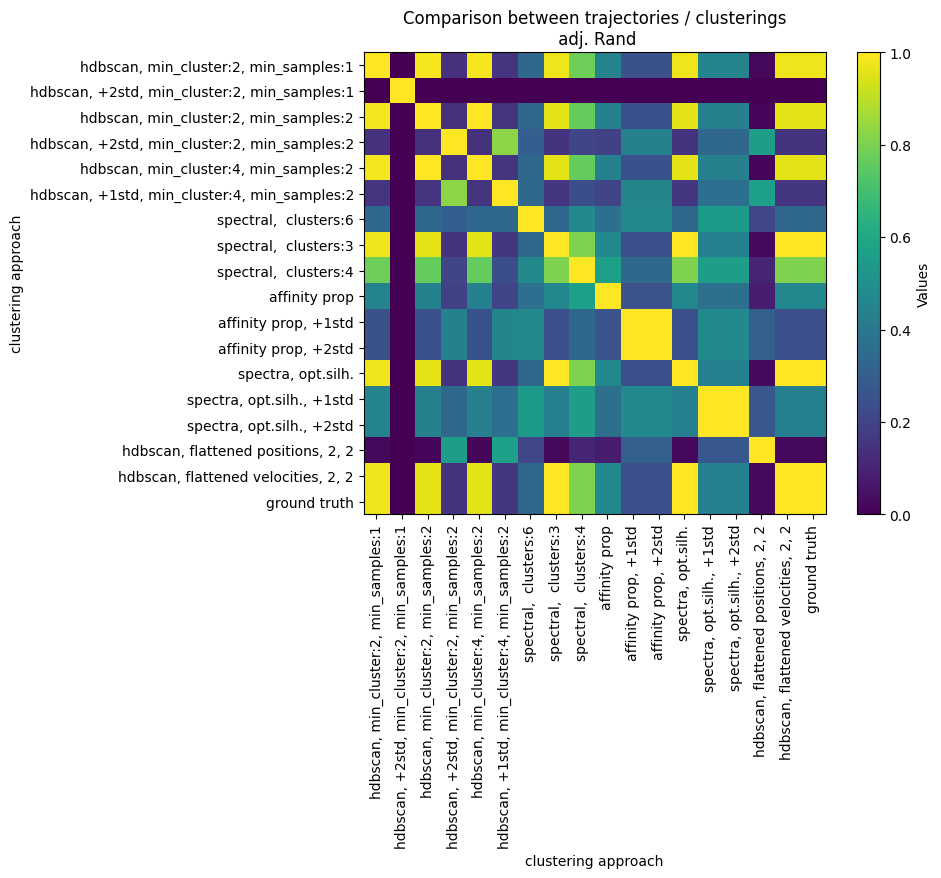

[[0, 0, 1.0],
 [0, 1, 0.0],
 [0, 2, 0.9855933808978652],
 [0, 3, 0.14294836563724103],
 [0, 4, 0.9855933808978652],
 [0, 5, 0.1543895134521949],
 [0, 6, 0.3385860179980174],
 [0, 7, 0.9743276283618582],
 [0, 8, 0.7784719136367201],
 [0, 9, 0.4466803251953417],
 [0, 10, 0.24739805317117533],
 [0, 11, 0.24739805317117533],
 [0, 12, 0.9743276283618582],
 [0, 13, 0.4463987101133783],
 [0, 14, 0.4463987101133783],
 [0, 15, 0.020698389056880165],
 [0, 16, 0.9743276283618582],
 [0, 17, 0.9743276283618582],
 [1, 0, 0.0],
 [1, 1, 1.0],
 [1, 2, 0.0],
 [1, 3, 0.0],
 [1, 4, 0.0],
 [1, 5, 0.0],
 [1, 6, 0.0],
 [1, 7, 0.0],
 [1, 8, 0.0],
 [1, 9, 0.0],
 [1, 10, 0.0],
 [1, 11, 0.0],
 [1, 12, 0.0],
 [1, 13, 0.0],
 [1, 14, 0.0],
 [1, 15, 0.0],
 [1, 16, 0.0],
 [1, 17, 0.0],
 [2, 0, 0.9855933808978652],
 [2, 1, 0.0],
 [2, 2, 1.0],
 [2, 3, 0.14110599232863977],
 [2, 4, 1.0],
 [2, 5, 0.15419755419438577],
 [2, 6, 0.3338324792336368],
 [2, 7, 0.959950897652294],
 [2, 8, 0.7617230923047577],
 [2, 9, 0.44115500

In [161]:
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = False, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

In [162]:
clustering_results

[[1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
 

In [163]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

In [164]:

new_plot_data = process_data.prepare_clustered_results_for_plotly(trajectories, np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')]))

In [165]:
%matplotlib notebook

ab_hsv = plot_functions.plot_traj_labels_plt(new_plot_data, save_video=False, interval = 10, color_map='Spectral', noise_label = -1, title = sim_command + "\n hdbscan, min_cluster:2, min_samples:2")

<IPython.core.display.Javascript object>

In [166]:
from IPython.display import HTML
HTML(ab_hsv.to_html5_video())